# Xing Lab Imaging Annotation Tutorial

In this tutorial, we will cover:
- use pillow to read and save images
- convert 16-bit tif images into gray scale
- enhance image contrast

Labelme can be used to annotate images, but it only receives images in RGB/grayscale formats, because these are standard color models used in common computer vision tools. This is the reason that we must convert our 16-bit imaging here for futher annotation. RBG/grayscale precision is enough for human eyes to manually segment images. Note that during segmentation model training/predicting, we should make inputs uniform. Weikang's previous training/prediction uses 16-bit images as input, so please use 16-bit images if you would like to reuse Weikang's pretrained models on A549 cell lines.  

## Install labelme tool

If using mac, you may need to install pyqt via `brew install pyqt`.

In [1]:
%pip install labelme
%pip install pillow, numpy

Note: you may need to restart the kernel to use updated packages.
ERROR: Invalid requirement: 'pillow,'
Note: you may need to restart the kernel to use updated packages.


Raw tiff images may have 16-bit depth, depending on your microscope settings. In this example, we use Thomas' 16-bit imaging results from Nikon microscope. This image comes from PCNA no treatment position XY1 ("XY1/a549_vim_rfp_pcna_gfp_time_lapse_72hr_no_treatment_011322_T001_XY1_C1").

Using pillow to read and do basic operations on images.

In [2]:
from PIL import Image, ImageEnhance
import numpy as np
# image_path = "/Users/random/xing-vimentin-dic-pipeline/test_data/thomas_test_data/XY1_test/a549_vim_rfp_pcna_gfp_time_lapse_72hr_no_treatment_011322_T001_XY1_C1.tif"
image_path = "./data/test_16bit_image.tif"

im = Image.open(image_path)

Pillow loads correct the image mode as shown below.

In [3]:
im.mode

'I;16'

Show the original image. We will make cells easier for human eyes to observe with enhanced contrast later.

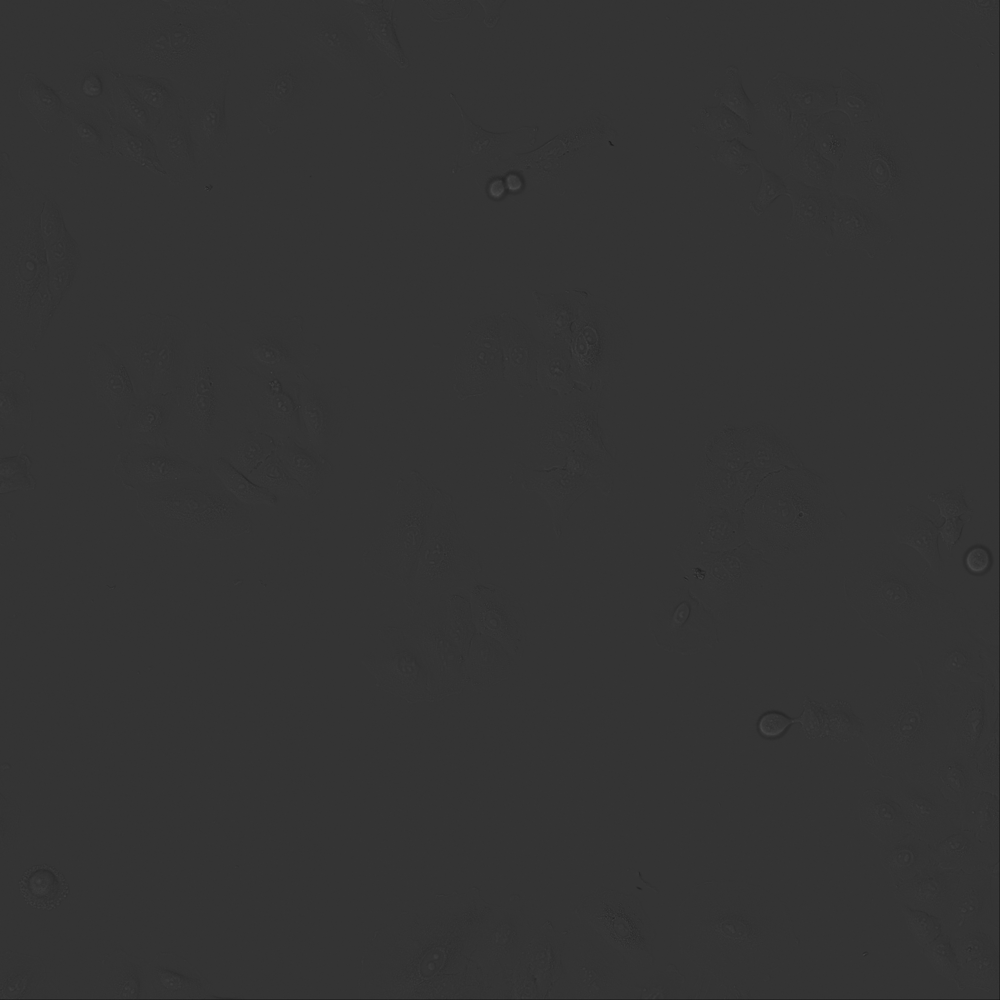

In [4]:
im

If we use convert to RGB or grayscale directly, it does not work. "L" stands for grayscale according to pillow's documentation. https://pillow.readthedocs.io/en/stable/reference/Image.html#PIL.Image.Image.convert

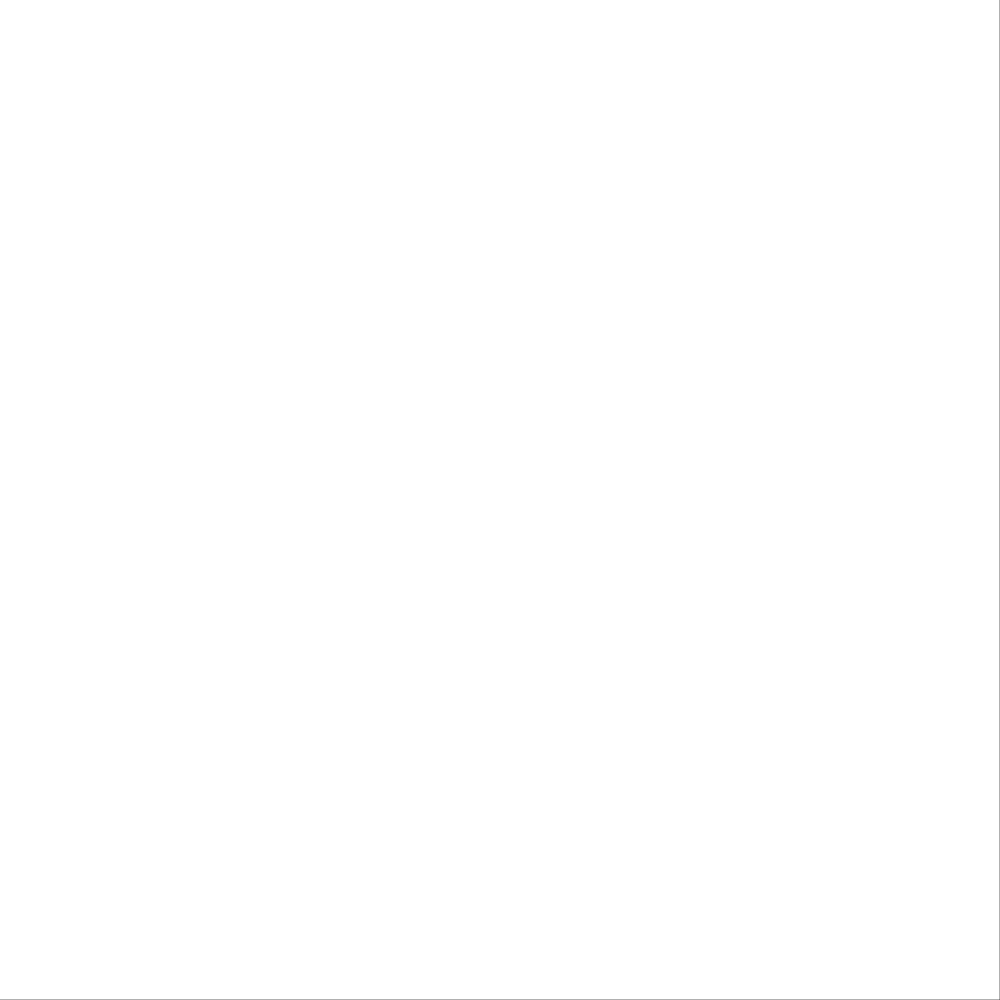

In [5]:
im.convert("L")

Lets write a utility function to normalize a 16-bit image to a grayscale image.

In [6]:
def to_gray_scale(image: Image, mode="L"):
    array = np.array(image)
    normalized = (array - array.min()) * \
        255.0 / (array.max() - array.min())
    image = Image.fromarray(normalized.astype(np.uint8), mode=mode)
    return image


grayscale_im = to_gray_scale(im)


In [7]:
grayscale_im.mode

'L'

Lets enhance the contrast of this image. You can adjust the factor based on your observation.

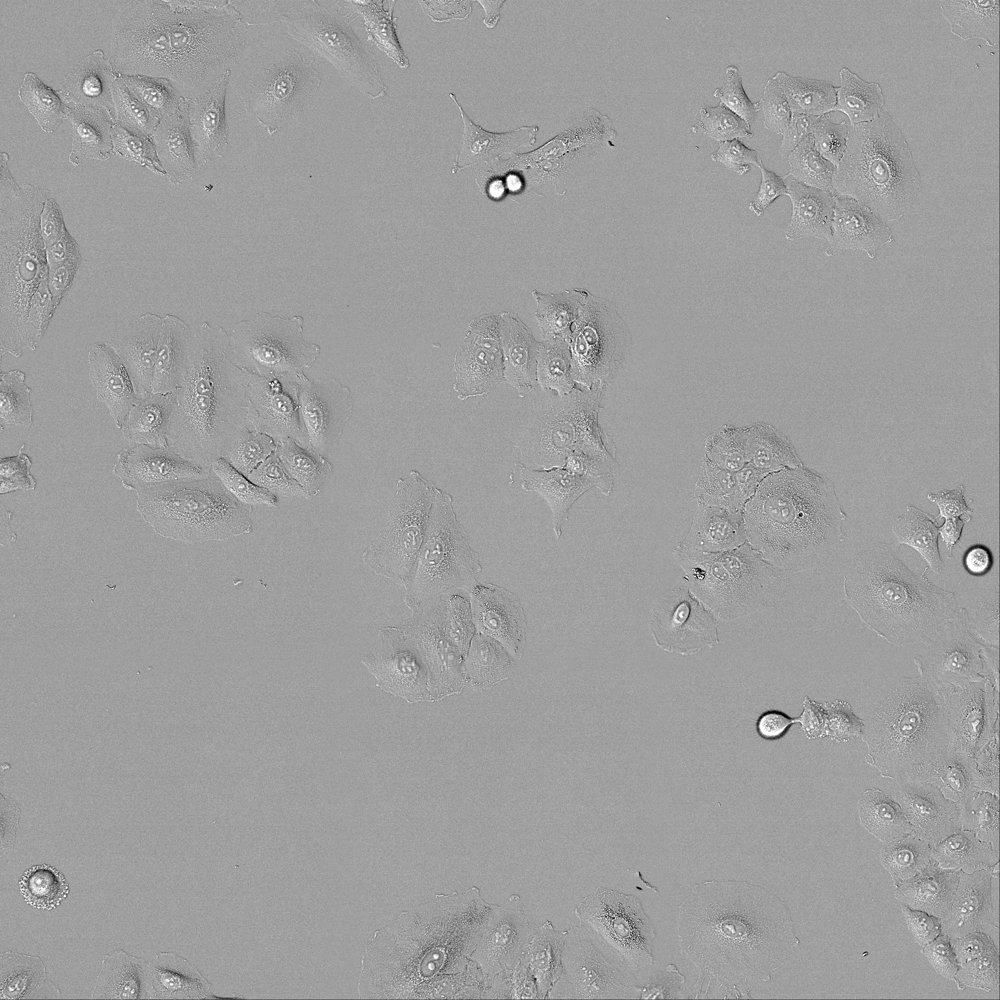

In [8]:
def enhance_contrast(im, factor=5):
    enhancer = ImageEnhance.Contrast(im)
    im_output = enhancer.enhance(factor)
    return im_output

enhanced_image = enhance_contrast(grayscale_im, factor=5)
enhanced_image

In [9]:
enhanced_image_path = "grayscale_enhanced_image.png"
enhanced_image.save(enhanced_image_path)

In [10]:
!labelme {enhanced_image_path}

[INFO   ] __init__:get_config:71 - Loading config file from: /Users/random/.labelmerc
